In [1]:
from STitch3D import *

/home/bhuaq/.conda/envs/stitch3d/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
import pandas as pd
import numpy as np
import scanpy as sc
import anndata as ad
import scipy  
import scipy.io  
import matplotlib.pyplot as plt
import os
import sys


import warnings
warnings.filterwarnings("ignore")

os.environ["CUDA_VISIBLE_DEVICES"] = "0"

# load datasets

## single-cell

In [3]:
mat = scipy.io.mmread("/home/bhuaq/STitch3D/math5472/data/GSE144136_GeneBarcodeMatrix_Annotated.mtx")
meta = pd.read_csv("/home/bhuaq/STitch3D/math5472/data/GSE144136_CellNames.csv", index_col=0)
meta.index = meta.x.values
group = [i.split('.')[1].split('_')[0] for i in list(meta.x.values)]
condition = [i.split('.')[1].split('_')[1] for i in list(meta.x.values)]
celltype = [i.split('.')[0] for i in list(meta.x.values)]
meta["group"] = group
meta["condition"] = condition
meta["celltype"] = celltype
genename = pd.read_csv("/home/bhuaq/STitch3D/math5472/data/GSE144136_GeneNames.csv", index_col=0)
genename.index = genename.x.values
adata_ref = ad.AnnData(X=mat.tocsr().T)
adata_ref.obs = meta
adata_ref.var = genename
adata_ref = adata_ref[adata_ref.obs.condition.values.astype(str)=="Control", :]

## spatial transcriptomics 

In [4]:

anno_df = pd.read_csv('/home/bhuaq/STitch3D/math5472/data/spatialLIBD/barcode_level_layer_map.tsv', sep='\t', header=None)

slice_idx = [151673, 151674, 151675, 151676]

adata_st1 = sc.read_visium(path="/home/bhuaq/STitch3D/math5472/data/spatialLIBD/%d" % slice_idx[0],
                          count_file="%d_filtered_feature_bc_matrix.h5" % slice_idx[0])
anno_df1 = anno_df.iloc[anno_df[1].values.astype(str) == str(slice_idx[0])]
anno_df1.columns = ["barcode", "slice_id", "layer"]
anno_df1.index = anno_df1['barcode']
adata_st1.obs = adata_st1.obs.join(anno_df1, how="left")
adata_st1 = adata_st1[adata_st1.obs['layer'].notna()]

adata_st2 = sc.read_visium(path="/home/bhuaq/STitch3D/math5472/data/spatialLIBD/%d" % slice_idx[1],
                          count_file="%d_filtered_feature_bc_matrix.h5" % slice_idx[1])
anno_df2 = anno_df.iloc[anno_df[1].values.astype(str) == str(slice_idx[1])]
anno_df2.columns = ["barcode", "slice_id", "layer"]
anno_df2.index = anno_df2['barcode']
adata_st2.obs = adata_st2.obs.join(anno_df2, how="left")
adata_st2 = adata_st2[adata_st2.obs['layer'].notna()]

adata_st3 = sc.read_visium(path="/home/bhuaq/STitch3D/math5472/data/spatialLIBD/%d" % slice_idx[2],
                          count_file="%d_filtered_feature_bc_matrix.h5" % slice_idx[2])
anno_df3 = anno_df.iloc[anno_df[1].values.astype(str) == str(slice_idx[2])]
anno_df3.columns = ["barcode", "slice_id", "layer"]
anno_df3.index = anno_df3['barcode']
adata_st3.obs = adata_st3.obs.join(anno_df3, how="left")
adata_st3 = adata_st3[adata_st3.obs['layer'].notna()]

adata_st4 = sc.read_visium(path="/home/bhuaq/STitch3D/math5472/data/spatialLIBD/%d" % slice_idx[3],
                          count_file="%d_filtered_feature_bc_matrix.h5" % slice_idx[3])
anno_df4 = anno_df.iloc[anno_df[1].values.astype(str) == str(slice_idx[3])]
anno_df4.columns = ["barcode", "slice_id", "layer"]
anno_df4.index = anno_df4['barcode']
adata_st4.obs = adata_st4.obs.join(anno_df4, how="left")
adata_st4 = adata_st4[adata_st4.obs['layer'].notna()]

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


## Alignment

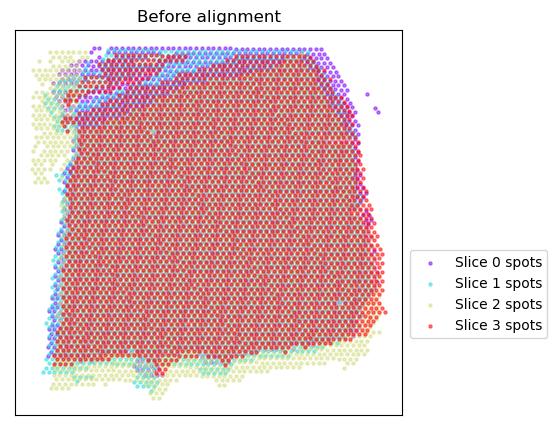

Using the Iterative Closest Point algorithm for alignemnt.
Detecting edges...


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


Aligning edges...


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


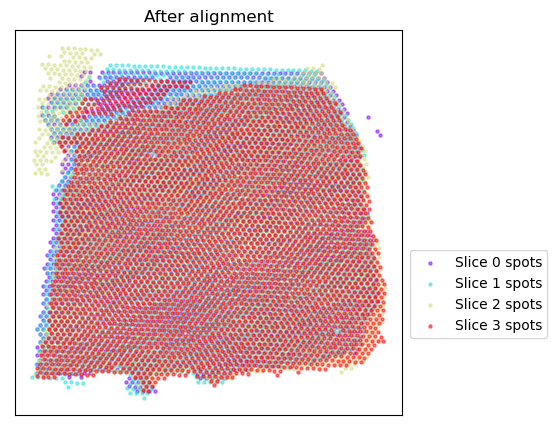

In [5]:
adata_st_list_raw = [adata_st1, adata_st2, adata_st3, adata_st4]
adata_st_list = STitch3D.utils.align_spots(adata_st_list_raw, plot=True)

In [6]:
celltype_list_use = ['Astros_1', 'Astros_2', 'Astros_3', 'Endo', 'Micro/Macro',
                     'Oligos_1', 'Oligos_2', 'Oligos_3',
                     'Ex_1_L5_6', 'Ex_2_L5', 'Ex_3_L4_5', 'Ex_4_L_6', 'Ex_5_L5',
                     'Ex_6_L4_6', 'Ex_7_L4_6', 'Ex_8_L5_6', 'Ex_9_L5_6', 'Ex_10_L2_4']

adata_st, adata_basis = STitch3D.utils.preprocess(adata_st_list,
                                                  adata_ref,
                                                  celltype_ref=celltype_list_use,
                                                  sample_col="group",
                                                  slice_dist_micron=[10., 300., 10.],
                                                  n_hvg_group=500)

Finding highly variable genes...


Trying to set attribute `.obs` of view, copying.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Trying to set attribute `.obs` of view, copying.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Trying to set attribute `.obs` of view, copying.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Trying to set attribute `.obs` of view, copying.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Trying to set attribute `.obs` of view, copying.
... storing 'group' as categorical
... storing 'condition' as categorical
... storing 'celltype' as categorical
Trying to set attribute `.obs` of view, copying.


4558 highly variable genes selected.
Calculate basis for deconvolution...
1 batches are used for computing the basis vector of cell type <Astros_1>.
17 batches are used for computing the basis vector of cell type <Astros_2>.
14 batches are used for computing the basis vector of cell type <Astros_3>.
17 batches are used for computing the basis vector of cell type <Endo>.
17 batches are used for computing the basis vector of cell type <Ex_10_L2_4>.
15 batches are used for computing the basis vector of cell type <Ex_1_L5_6>.
15 batches are used for computing the basis vector of cell type <Ex_2_L5>.
17 batches are used for computing the basis vector of cell type <Ex_3_L4_5>.
14 batches are used for computing the basis vector of cell type <Ex_4_L_6>.
17 batches are used for computing the basis vector of cell type <Ex_5_L5>.
16 batches are used for computing the basis vector of cell type <Ex_6_L4_6>.
16 batches are used for computing the basis vector of cell type <Ex_7_L4_6>.
15 batches are 

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


Start building a graph...
Radius for graph connection is 150.7000.
9.8415 neighbors per cell on average.


# Run Model

In [7]:
model = STitch3D.model.Model(adata_st, adata_basis, training_steps = 2000)

model.train(step_interval=200)

  0%|          | 1/2000 [00:03<1:50:05,  3.30s/it]

Step: 0, Loss: 2436.9839, d_loss: 2431.3972, f_loss: 55.8676


 10%|█         | 202/2000 [00:45<06:21,  4.72it/s]

Step: 200, Loss: 1261.6876, d_loss: 1258.3595, f_loss: 33.2807


 20%|██        | 402/2000 [01:28<05:41,  4.67it/s]

Step: 400, Loss: 1089.0706, d_loss: 1085.7542, f_loss: 33.1646


 30%|███       | 602/2000 [02:11<05:00,  4.66it/s]

Step: 600, Loss: 968.8192, d_loss: 965.5053, f_loss: 33.1390


 40%|████      | 802/2000 [02:54<04:17,  4.65it/s]

Step: 800, Loss: 888.4991, d_loss: 885.1867, f_loss: 33.1245


 50%|█████     | 1002/2000 [03:38<03:34,  4.64it/s]

Step: 1000, Loss: 836.9149, d_loss: 833.6044, f_loss: 33.1046


 60%|██████    | 1202/2000 [04:21<02:51,  4.64it/s]

Step: 1200, Loss: 803.5867, d_loss: 800.2786, f_loss: 33.0808


 70%|███████   | 1402/2000 [05:04<02:08,  4.65it/s]

Step: 1400, Loss: 781.3138, d_loss: 778.0079, f_loss: 33.0593


 80%|████████  | 1602/2000 [05:48<01:25,  4.64it/s]

Step: 1600, Loss: 765.9798, d_loss: 762.6743, f_loss: 33.0545


 90%|█████████ | 1802/2000 [06:31<00:42,  4.65it/s]

Step: 1800, Loss: 755.0179, d_loss: 751.7140, f_loss: 33.0394


100%|██████████| 2000/2000 [07:14<00:00,  4.60it/s]


In [8]:
save_path = "/home/bhuaq/STitch3D/math5472/results/dlpfc"
result = model.eval(adata_st_list_raw, save=True, output_path=save_path)

... storing 'layer' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'layer' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'layer' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'layer' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


## Plot

In [11]:
data_st_list_raw = [adata_st1, adata_st2, adata_st3, adata_st4]
adata_st_list = STitch3D.utils.align_spots(adata_st_list_raw, plot=False)
celltype_list_use = ['Astros_1', 'Astros_2', 'Astros_3', 'Endo', 'Micro/Macro',
                     'Oligos_1', 'Oligos_2', 'Oligos_3',
                     'Ex_1_L5_6', 'Ex_2_L5', 'Ex_3_L4_5', 'Ex_4_L_6', 'Ex_5_L5',
                     'Ex_6_L4_6', 'Ex_7_L4_6', 'Ex_8_L5_6', 'Ex_9_L5_6', 'Ex_10_L2_4']

adata_st, adata_basis = STitch3D.utils.preprocess(adata_st_list,
                                                  adata_ref,
                                                  celltype_ref=celltype_list_use,
                                                  sample_col="group",
                                                  slice_dist_micron=[10., 300., 10.],
                                                  n_hvg_group=500)

Using the Iterative Closest Point algorithm for alignemnt.
Detecting edges...
Aligning edges...
Finding highly variable genes...


Trying to set attribute `.obs` of view, copying.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Trying to set attribute `.obs` of view, copying.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Trying to set attribute `.obs` of view, copying.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Trying to set attribute `.obs` of view, copying.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Trying to set attribute `.obs` of view, copying.
... storing 'group' as categorical
... storing 'condition' as categorical
... storing 'celltype' as categorical


4558 highly variable genes selected.
Calculate basis for deconvolution...


Trying to set attribute `.obs` of view, copying.


1 batches are used for computing the basis vector of cell type <Astros_1>.
17 batches are used for computing the basis vector of cell type <Astros_2>.
14 batches are used for computing the basis vector of cell type <Astros_3>.
17 batches are used for computing the basis vector of cell type <Endo>.
17 batches are used for computing the basis vector of cell type <Ex_10_L2_4>.
15 batches are used for computing the basis vector of cell type <Ex_1_L5_6>.
15 batches are used for computing the basis vector of cell type <Ex_2_L5>.
17 batches are used for computing the basis vector of cell type <Ex_3_L4_5>.
14 batches are used for computing the basis vector of cell type <Ex_4_L_6>.
17 batches are used for computing the basis vector of cell type <Ex_5_L5>.
16 batches are used for computing the basis vector of cell type <Ex_6_L4_6>.
16 batches are used for computing the basis vector of cell type <Ex_7_L4_6>.
15 batches are used for computing the basis vector of cell type <Ex_8_L5_6>.
13 batches a

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


Start building a graph...
Radius for graph connection is 150.7000.
9.8415 neighbors per cell on average.


In [12]:
latent_rep = pd.read_csv(save_path + "/representation.csv", index_col=0)
adata_st.obsm["latent"] =latent_rep.values
adata_st1 = sc.read_h5ad(save_path + "/res_adata_slice0.h5ad")
adata_st2 = sc.read_h5ad(save_path + "/res_adata_slice1.h5ad")
adata_st3 = sc.read_h5ad(save_path + "/res_adata_slice2.h5ad")
adata_st4 = sc.read_h5ad(save_path + "/res_adata_slice3.h5ad")
adata_st_list = [adata_st1, adata_st2, adata_st3, adata_st4]

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [16]:
from sklearn.mixture import GaussianMixture

np.random.seed(1234)
gm = GaussianMixture(n_components=7, covariance_type='tied', init_params='kmeans')
y = gm.fit_predict(model.adata_st.obsm['latent'], y=None)
model.adata_st.obs["GM"] = y
model.adata_st.obs["GM"].to_csv(os.path.join(save_path, "clustering_result.csv"))

# Restoring clustering labels to result
order = [2,4,6,0,3,5,1] # reordering cluster labels
model.adata_st.obs["Cluster"] = [order[label] for label in model.adata_st.obs["GM"].values]
for i in range(len(result)):
    result[i].obs["GM"] = model.adata_st.obs.loc[result[i].obs_names, ]["GM"]
    result[i].obs["Cluster"] = model.adata_st.obs.loc[result[i].obs_names, ]["Cluster"]

Slice 151673 spatial domain detection result:


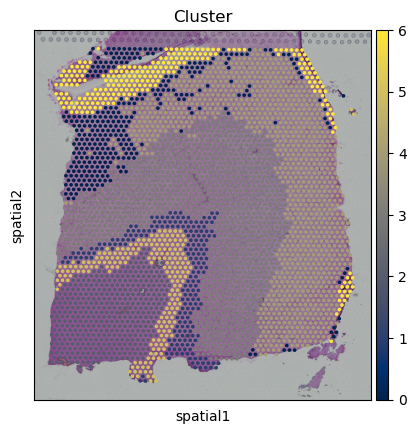

Slice 151674 spatial domain detection result:


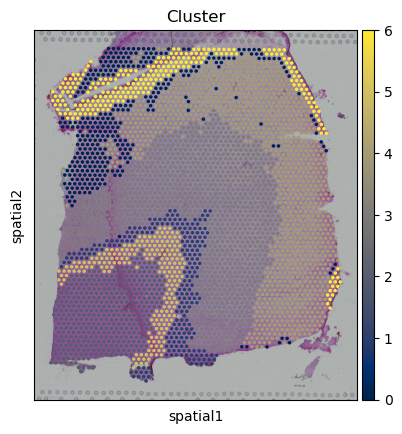

Slice 151675 spatial domain detection result:


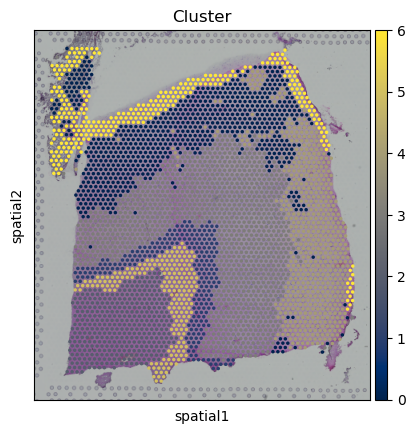

Slice 151676 spatial domain detection result:


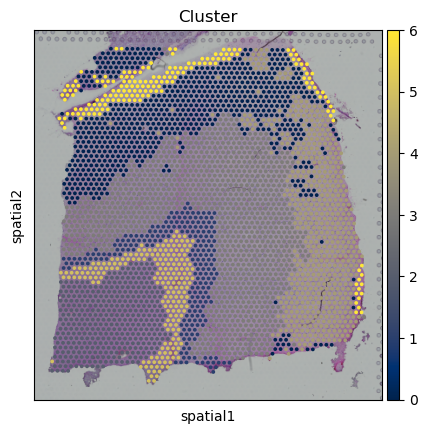

In [17]:
for i, adata_st_i in enumerate(result):
    print("Slice %d spatial domain detection result:" % slice_idx[i])
    sc.pl.spatial(adata_st_i, img_key="lowres", color="Cluster", color_map="cividis", size=1.)

Slice 151673 cell-type deconvolution result:


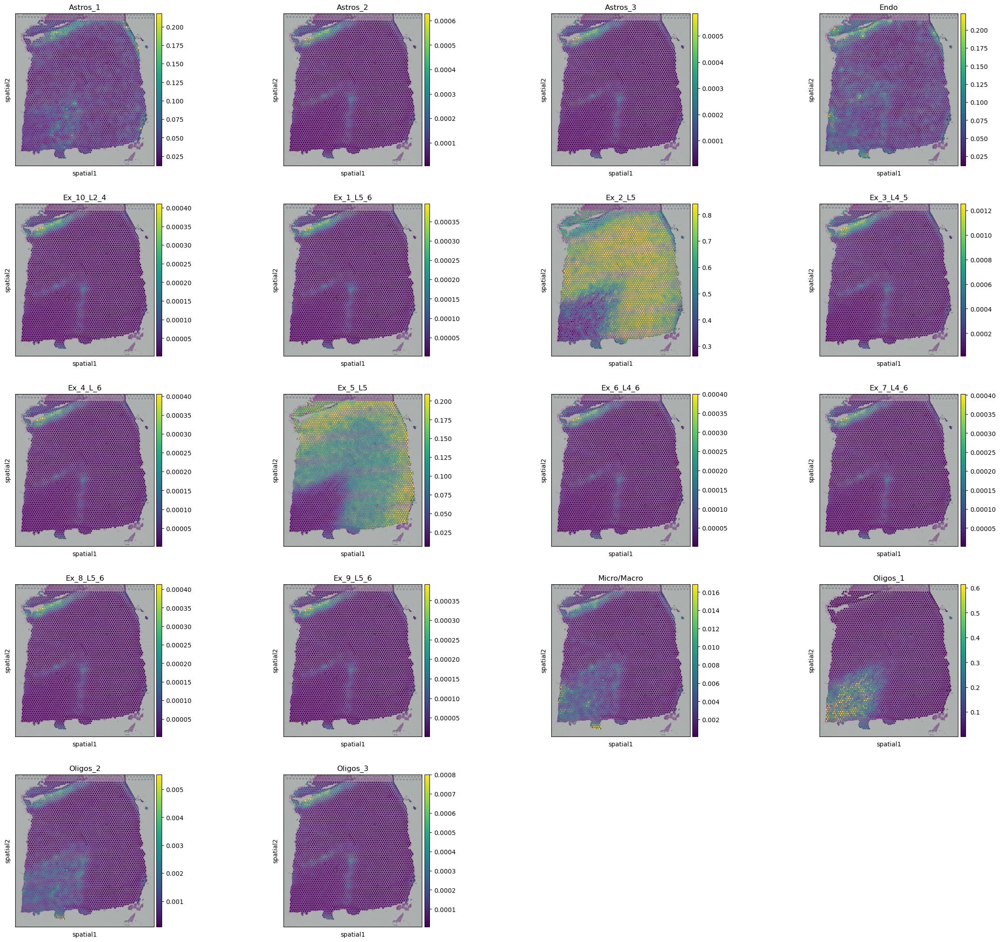

Slice 151674 cell-type deconvolution result:


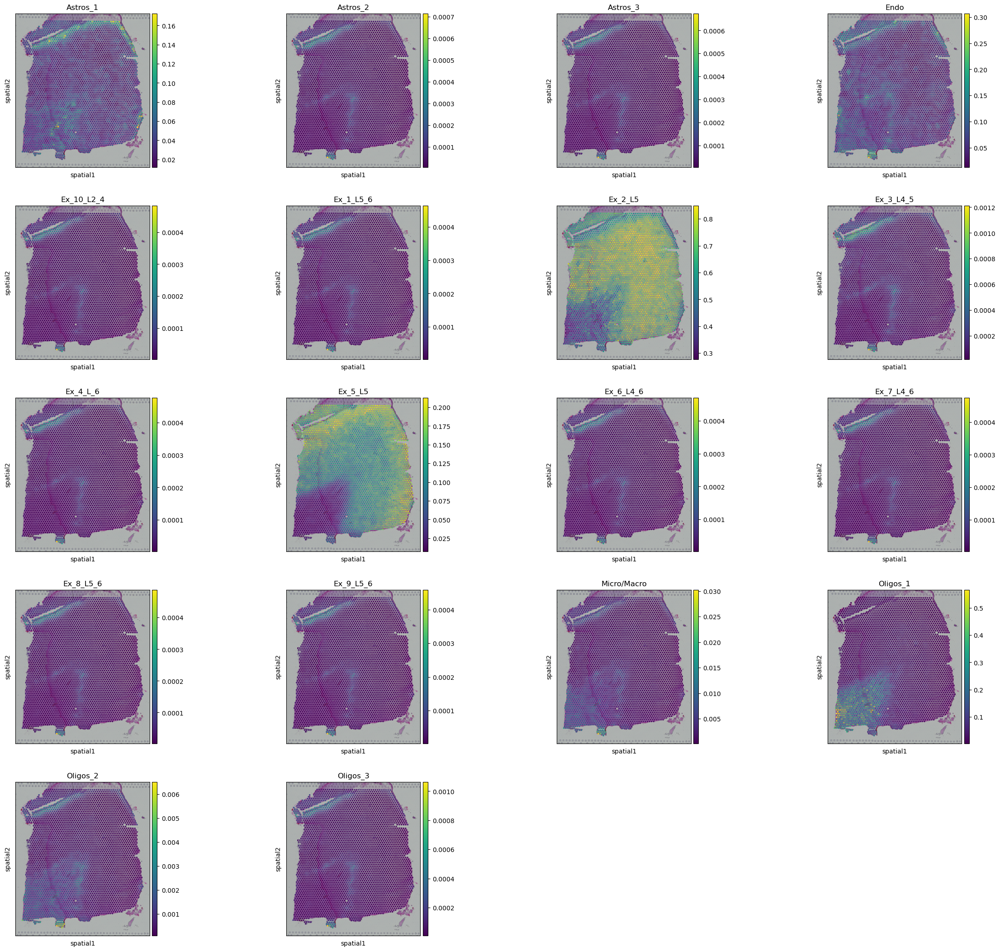

Slice 151675 cell-type deconvolution result:


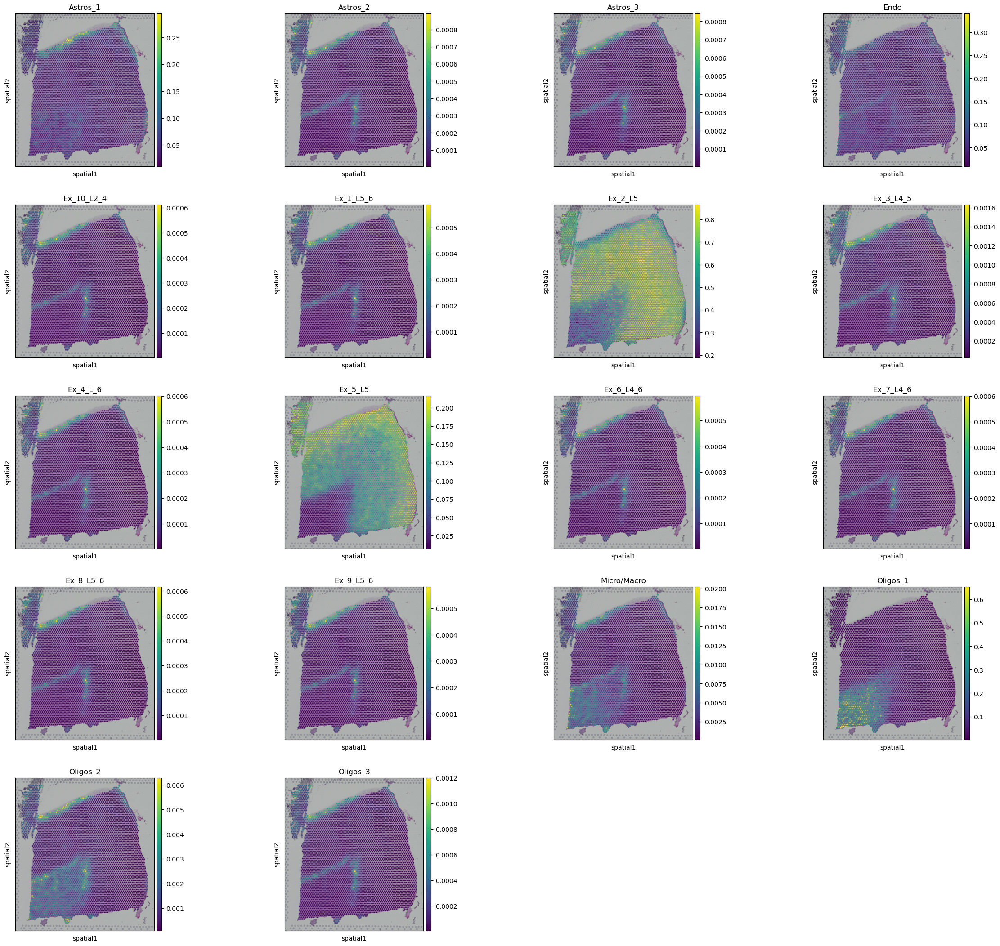

Slice 151676 cell-type deconvolution result:


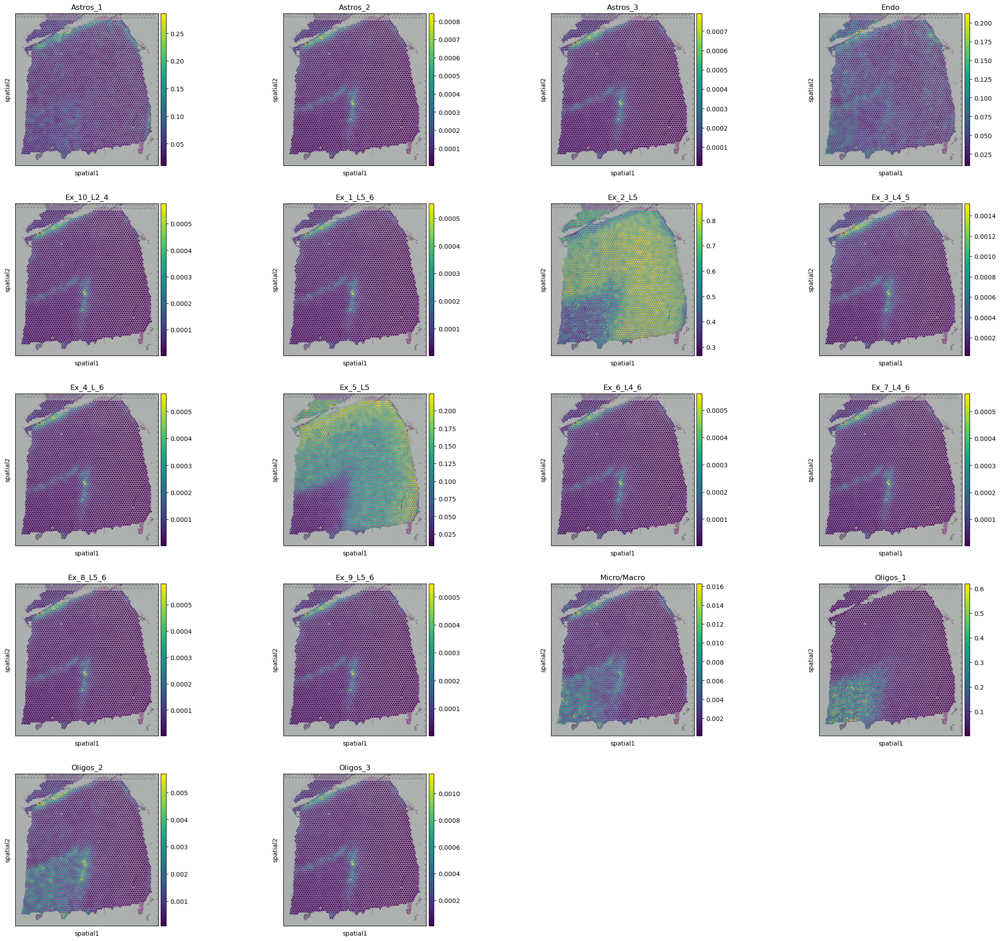

In [18]:
for i, adata_st_i in enumerate(result):
    print("Slice %d cell-type deconvolution result:" % slice_idx[i])
    sc.pl.spatial(adata_st_i, img_key="lowres", color=list(adata_basis.obs.index), size=1.)

In [29]:
import umap

reducer = umap.UMAP(n_neighbors=30,
                    n_components=2,
                    metric="correlation",
                    n_epochs=None,
                    learning_rate=1.0,
                    min_dist=0.3,
                    spread=1.0,
                    set_op_mix_ratio=1.0,
                    local_connectivity=1,
                    repulsion_strength=1,
                    negative_sample_rate=5,
                    a=None,
                    b=None,
                    random_state=1234,
                    metric_kwds=None,
                    angular_rp_forest=False,
                    verbose=True)

embedding = reducer.fit_transform(model.adata_st.obsm['latent'])

n_spots = embedding.shape[0]
size = 120000 / n_spots


UMAP(angular_rp_forest=True, local_connectivity=1, metric='correlation', min_dist=0.3, n_jobs=1, n_neighbors=30, random_state=1234, repulsion_strength=1, verbose=True)
Sat Dec 14 21:50:09 2024 Construct fuzzy simplicial set
Sat Dec 14 21:50:09 2024 Finding Nearest Neighbors
Sat Dec 14 21:50:09 2024 Building RP forest with 11 trees
Sat Dec 14 21:50:09 2024 NN descent for 14 iterations
	 1  /  14
	 2  /  14
	 3  /  14
	Stopping threshold met -- exiting after 3 iterations
Sat Dec 14 21:50:12 2024 Finished Nearest Neighbor Search
Sat Dec 14 21:50:12 2024 Construct embedding


Epochs completed:   2%| ▎          5/200 [00:00]

	completed  0  /  200 epochs


Epochs completed:  14%| █▍         28/200 [00:01]

	completed  20  /  200 epochs


Epochs completed:  24%| ██▍        49/200 [00:02]

	completed  40  /  200 epochs


Epochs completed:  34%| ███▎       67/200 [00:03]

	completed  60  /  200 epochs


Epochs completed:  44%| ████▍      88/200 [00:03]

	completed  80  /  200 epochs


Epochs completed:  55%| █████▍     109/200 [00:04]

	completed  100  /  200 epochs


Epochs completed:  64%| ██████▎    127/200 [00:05]

	completed  120  /  200 epochs


Epochs completed:  74%| ███████▍   148/200 [00:06]

	completed  140  /  200 epochs


Epochs completed:  84%| ████████▍  169/200 [00:07]

	completed  160  /  200 epochs


Epochs completed:  94%| █████████▎ 187/200 [00:08]

	completed  180  /  200 epochs


Epochs completed: 100%| ██████████ 200/200 [00:09]


Sat Dec 14 21:50:21 2024 Finished embedding


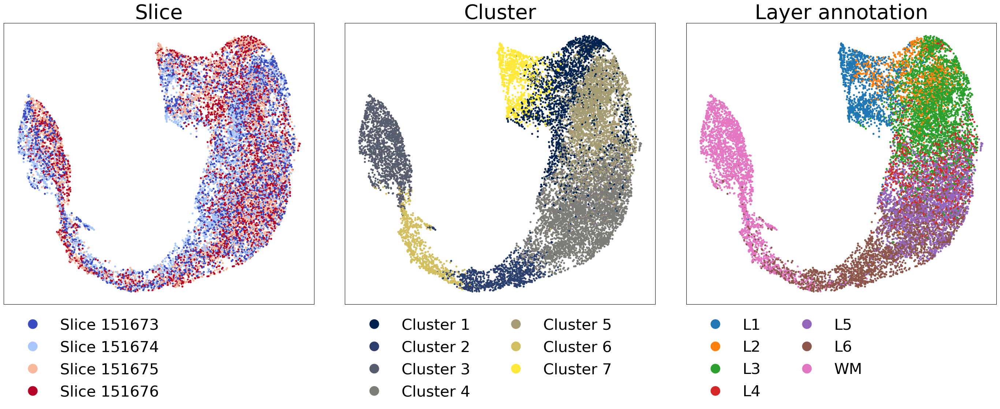

In [32]:
from sklearn import preprocessing
from matplotlib.colors import ListedColormap

le_slice = preprocessing.LabelEncoder()
label_slice = le_slice.fit_transform(adata_st.obs['slice_id'])

le_layer = preprocessing.LabelEncoder()
label_layer = le_layer.fit_transform(adata_st.obs['layer'])

np.random.seed(1234)
order = np.arange(n_spots)
np.random.shuffle(order)

f = plt.figure(figsize=(35,10))  # 调整图像大小,因为少了一个子图

ax1 = f.add_subplot(1,3,1)  # 改为1,3,1
scatter1 = ax1.scatter(embedding[order, 0], embedding[order, 1],
                       s=size, c=label_slice[order], cmap='coolwarm')
ax1.set_title("Slice", fontsize=40)
ax1.tick_params(axis='both',bottom=False, top=False, left=False, right=False, labelleft=False, labelbottom=False, grid_alpha=0)

l1 = ax1.legend(handles=scatter1.legend_elements()[0],
                labels=["Slice %d" % i for i in slice_idx],
                loc="upper left", bbox_to_anchor=(0., 0.),
                markerscale=3., title_fontsize=45, fontsize=30, frameon=False, ncol=1)
l1._legend_box.align = "left"

ax2 = f.add_subplot(1,3,2)  # 改为1,3,2
scatter2 = ax2.scatter(embedding[order, 0], embedding[order, 1],
                       s=size, c=adata_st.obs['Cluster'][order], cmap='cividis')
ax2.set_title("Cluster", fontsize=40)
ax2.tick_params(axis='both',bottom=False, top=False, left=False, right=False, labelleft=False, labelbottom=False, grid_alpha=0)

l2 = ax2.legend(handles=scatter2.legend_elements()[0],
                labels=["Cluster %d" % i for i in range(1, 8)],
                loc="upper left", bbox_to_anchor=(0., 0.),
                markerscale=3., title_fontsize=45, fontsize=30, frameon=False, ncol=2)
l2._legend_box.align = "left"

ax3 = f.add_subplot(1,3,3)  # 改为1,3,3
scatter3 = ax3.scatter(embedding[order, 0], embedding[order, 1],
                       s=size, c=label_layer[order], cmap=ListedColormap(["#1f77b4", "#ff7f0e", "#2ca02c", "#d62728", "#9467bd", "#8c564b", "#e377c2"]))
ax3.set_title("Layer annotation", fontsize=40)
ax3.tick_params(axis='both',bottom=False, top=False, left=False, right=False, labelleft=False, labelbottom=False, grid_alpha=0)

l3 = ax3.legend(handles=scatter3.legend_elements()[0],
                labels=sorted(set(adata_st.obs['layer'].values)),
                loc="upper left", bbox_to_anchor=(0., 0.),
                markerscale=3., title_fontsize=45, fontsize=30, frameon=False, ncol=2)
l3._legend_box.align = "left"

f.subplots_adjust(hspace=.1, wspace=.1)
plt.show()